# Text to Text Explanation

In [1]:
%load_ext autoreload 
%autoreload 2

In [2]:
from rdkit import Chem
import re

In [3]:
import numpy as np
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM
import shap
import torch

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

In [4]:
from EFGs import mol2frag

In [5]:
from matplotlib import cm

In [6]:
def map_atom2stridx(smiles):
    pattern = "[=#]?(\[[^\]]+\]|Br?|Cl?|N|O|S|P|F|I|b|c|n|o|s|p)[0-9]{0,2}"
    atom_finder = re.compile(pattern)
    ms = [x for x in atom_finder.finditer(smiles)]
    map_dict = {i:(x.start(),x.end()) for i,x in enumerate(ms)}
#     print(map_dict)
    smiles = smiles.replace('>>', '.') if '>>' in smiles else smiles.replace('>', '.')
    assert Chem.MolFromSmiles(smiles).GetNumAtoms() == len(map_dict)
    return map_dict

In [7]:
# import packages
from rdkit import Chem
# from rdkit.Chem.Draw import IPythonConsole
from IPython.display import SVG, Image
from rdkit.Chem import rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D

def prettymol(smiles, asMol=False, label=None, path='', imgsize=(300, 200), highlights=None):
    '''
    highlights is a dictionary, which may contains:
    highlightAtoms: list
    highlightBonds: list
    highlightAtomRadii: dict[int]=float, atom index (int), radius (float)
    highlightAtomColors: dict[int]=tuple, index (int), color (tuple, length=3)
    highlightBondColors: dict[int]=tuple,index (int), color (tuple, length=3)
    '''
    if asMol:
        mol = smiles.__copy__()
    else:
        mol = Chem.MolFromSmiles(smiles)
    mol = rdMolDraw2D.PrepareMolForDrawing(mol)
    if '.png' in path:
        drawer = rdMolDraw2D.MolDraw2DCairo(*imgsize)
    else:
        drawer = rdMolDraw2D.MolDraw2DSVG(*imgsize)
    opts = drawer.drawOptions()
    if label == 'map':
        for i in range(mol.GetNumAtoms()):
            opts.atomLabels[i] = mol.GetAtomWithIdx(
                i).GetSymbol()+str(mol.GetAtomWithIdx(i).GetAtomMapNum())
    elif label == 'idx':
        for i in range(mol.GetNumAtoms()):
            opts.atomLabels[i] = mol.GetAtomWithIdx(i).GetSymbol()+str(i)
    else:
        _ = [a.ClearProp('molAtomMapNumber') for a in mol.GetAtoms()]
    if not highlights:
        drawer.DrawMolecule(mol)
    else:
        drawer.DrawMolecule(mol, **highlights)
    drawer.FinishDrawing()
    if '.png' in path:
        drawer.WriteDrawingText(path)
        display(Image(path))
    else:
        svg = drawer.GetDrawingText()
        display(SVG(svg.replace('svg:','')))
        if '.svg' in path:
            with open(path, 'w') as wf:
                print(svg, file=wf)
    return drawer

## Forward reaction prediction and single-step retrosynthesis

In [8]:
from IPython.core.debugger import set_trace

In [9]:
from functools import partial

In [10]:
from transformers import T5Config, T5ForConditionalGeneration                   
                                                                                
from data import T5MolTokenizer, T5SelfiesTokenizer, T5SimpleTokenizer, TaskPrefixDataset, data_collator
from models import T5ForSoftLabel

In [11]:
# load the model and tokenizer
tokenizer = T5SimpleTokenizer(vocab_file='../models/USPTO_TPL/bidirectional/vocab.pt', max_size=100)
model = T5ForConditionalGeneration.from_pretrained("../models/USPTO_TPL/bidirectional/")#.cuda()
# model = T5ForSoftLabel.from_pretrained('../models/USPTO_TPL/Classification/') 
model.config.task_specific_params = {}
model.config.task_specific_params["text-generation"] = {                                                             
          "early_stopping": True,                                                 
          "max_length": 50,                                 
#           "num_beams": 10,                                            
#           "num_return_sequences": 1,                                 
          "decoder_start_token_id": tokenizer.pad_token_id,                       
#           "repetition_penalty": 0,                                 
        }
# define the input sentences we want to translate
data = [
    "Product:CO.CSc1ccc([N+](=O)[O-])c(C(=O)O)c1.[H][H].[Ni]>>",
    #"CSc1ccc(N)c(C(=O)O)c1",
    "Product:CI.CN(C)C=O.COc1ccc(Cn2c(=O)cc(C(F)(F)F)[nH]c2=O)cc1.Cl.O=C([O-])[O-].[K+].[K+]>>",
    #"COc1ccc(Cn2c(=O)cc(C(F)(F)F)n(C)c2=O)cc1"
    "Retrosynthesis:CSc1ccc(N)c(C(=O)O)c1",
    # CSc1ccc([N+](=O)[O-])c(C(=O)O)c1
    "Retrosynthesis:CN1C(=O)[C@@H]2CCCN2C[C@H]1CO[Si](C)(C)C(C)(C)C",
    # CC(C)(C)[Si](C)(C)OC[C@@H]1CN2CCC[C@H]2C(=O)N1.CI
]

### Explain the model's predictions

In [12]:
# we build an explainer by passing the model we want to explain and
# the tokenizer we want to use to break up the input strings
# wrapped_model = shap.models.TopKLM(model, tokenizer, k=100)
# set_trace()
explainer = shap.Explainer(model,tokenizer)
# explainers are callable, just like models
# masker = shap.maskers.Text(tokenizer, mask_token = "<mask>", collapse_mask_token=True)
# explainer = shap.Explainer(wrapped_model,masker)
shap_values = explainer(data)

In [40]:
example_id = 2

In [42]:
tokens = ''.join(tokenizer.tokenize(data[example_id])[1:])

In [43]:
map_dict = map_atom2stridx(tokens)

In [44]:
tokens

'CSc1ccc(N)c(C(=O)O)c1'

In [45]:
mol = Chem.MolFromSmiles(tokens)
fgs, fgs_ch, fg_ids, fg_chids = mol2frag(mol, returnidx=True)

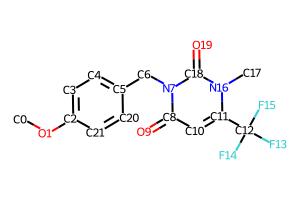

In [46]:
prettymol("COc1ccc(Cn2c(=O)cc(C(F)(F)F)n(C)c2=O)cc1", label='idx')

In [47]:
prod_dict = {0:"CSc1ccc(N)c(C(=O)O)c1", 1:"COc1ccc(Cn2c(=O)cc(C(F)(F)F)n(C)c2=O)cc1", 
             2:"CSc1ccc([N+](=O)[O-])c(C(=O)O)c1", 3:"CC(C)(C)[Si](C)(C)OC[C@@H]1CN2CCC[C@H]2C(=O)N1.CI"}
react_idx = {0:(6,), 1:range(20), 
             2:(6,7,8), 3:(18,19,20)}
map_dict_target = map_atom2stridx(prod_dict[example_id])
selected_index = []
for idx in react_idx[example_id]:
    selected_index += list(range(map_dict_target[idx][0], map_dict_target[idx][1]))
selected_index

[8, 9, 10, 11, 13, 14, 16, 17, 18, 19]

In [48]:
class colorscaler(object):
    def __init__(self,array):
        self.max = int(max(array)*400)
        
    def convert(self, value):
        return int(self.max/2+value*100)

In [49]:
def token2fg(fgids, map_dict):
    from itertools import chain
    fg_dict = {}
    for i,fg in enumerate(fgids):
        for a in fg:
            fg_dict[i] = list(chain(fg_dict.get(i,[]), range(map_dict[a][0],map_dict[a][1])))
    fg_dict_reverse = {val:key for key,values in fg_dict.items() for val in values}
    for i in range(len(tokens)):
        if not i in fg_dict_reverse:
            if i-1 in fg_dict_reverse and i+1 in fg_dict_reverse:
                if tokens[i] in ('.', '>'):
                    continue
                elif tokens[i] == '(':
                    fg_dict_reverse[i] = fg_dict_reverse[i+1]
                else:
                    fg_dict_reverse[i] = fg_dict_reverse[i-1]
    for i,j in fg_dict_reverse.items():
        if i in fg_dict[j]: continue
        else:
            fg_dict[j].append(i)
    return fg_dict

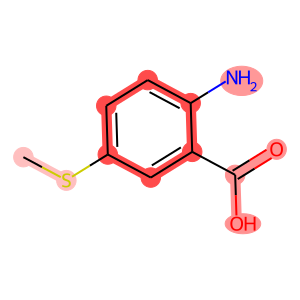

In [50]:
#mol_smi = Chem.MolFromSmiles(tokens.replace('>>','.'))
color_atoms = map_dict.keys()
shap_tokens = np.sum(shap_values[example_id].values[:,range(min(selected_index), max(selected_index)+1)], axis=1)
cs = colorscaler(shap_tokens)
bwr = cm.get_cmap('bwr', cs.max)
color_dicts_a = {}
color_dicts_b = {}
# for a in color_atoms:
#     val = sum(shap_tokens[map_dict[a][0]:map_dict[a][1]])
#     color_dicts_a[a] = bwr(cs.convert(val))[:3]
token_map = token2fg(fg_ids+fg_chids, map_dict)
for i,fg in enumerate(fg_ids+fg_chids):
    shap_val = shap_tokens[token_map[i]]
    for a in fg:
        color_dicts_a[a] = bwr(cs.convert(np.sum(shap_val)/2))#(1,1,1-np.max(np.exp(shap_val))/det*500)
for bond in mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_atoms and b in color_atoms and color_dicts_a[a]==color_dicts_a[b]:
        color_dicts_b[bond.GetIdx()] = color_dicts_a[a]
prettymol(mol, asMol=True, highlights={'highlightAtoms':color_atoms, 'highlightAtomColors':color_dicts_a, 'highlightBonds':{}, 'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b}, imgsize=(300,300))#, label='idx')
#,'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b

### Visualize shap explanations

In [362]:
# "CSc1ccc(N)c(C(=O)O)c1",
# "FC(F)(F)c1cccnc1N1CCNCC1"
# CC(C)(C)OC(=O)OC(=O)OC(C)(C)C.NCC1CCNCC1
# Cc1c(I)ccc(F)c1CO.O=S(Cl)Cl

In [41]:
shap.plots.text(shap_values)#, group_threshold=10e-5)

,Product: C O,.,C S c 1 c c c,( [ N + ] ( = O ),[ O - ] ),c ( C ( = O ),O ),c 1 . [ H ] [ H ] .,[ N i ] > >
C,6.159,3.507,11.58,6.108,-0.834,-1.165,-0.272,-0.494,-0.353
S,-2.768,-0.532,23.884,6.821,-0.522,-2.42,-0.494,0.786,2.176
c,1.852,1.018,16.566,5.867,-0.226,-3.863,0.671,2.194,1.236
1,0.259,-0.043,0.959,-0.104,-0.717,-0.073,0.161,0.703,0.496
c,-0.048,0.208,7.263,3.486,-0.637,0.849,1.101,4.254,0.91
c,0.34,0.068,8.562,2.363,-4.218,-4.252,2.694,7.026,1.195
c,0.827,0.105,17.753,5.366,-1.427,-4.909,-1.569,0.222,0.827
(,0.796,0.166,1.181,12.767,1.399,2.536,0.855,-0.006,0.215
N,1.31,0.013,14.162,14.015,-0.784,-3.011,-1.091,-0.497,1.67
),4.768,1.502,5.394,5.065,-0.3,0.734,-0.539,2.193,1.369


,Product: C C ( C ) ( C ),[ S i ] ( C ),( C ),O C [ C @ @ H ],1 C N 2 C C C [,C @ H ] 2 C ( = O ) N 1 .,C I .,C N ( C ) C = O .,[ H - ] . [ N a + ] > >
C,5.959,-0.186,0.371,-3.284,-2.725,2.3,14.947,6.423,-1.648
N,-5.581,-0.658,0.902,-2.614,-0.819,2.89,9.613,6.563,-1.744
1,-2.688,-1.266,-0.57,-1.326,8.142,12.775,5.456,-2.218,1.87
C,4.965,-0.943,-0.396,-1.92,2.322,-3.261,0.781,4.062,1.277
(,4.714,2.854,1.844,-1.172,-13.746,14.915,0.047,-0.419,0.321
=,-2.258,-0.625,-0.217,1.155,-0.014,15.909,-0.015,2.804,-0.031
O,2.344,-0.511,-0.245,-1.552,-1.402,5.505,0.893,0.774,1.748
),1.519,-0.137,-0.143,-0.411,-0.633,-0.456,0.236,-0.012,0.502
[,-1.497,3.427,1.607,7.512,-2.619,19.306,-1.883,-1.772,-3.565
C,0.214,1.344,0.632,9.529,6.659,9.15,-0.643,-3.2,2.761


,Retrosynthesis: C S c,1 c,c c,(,N ),c,( C,( = O ),O ),c 1
C,10.911,2.215,1.24,1.697,2.309,0.847,0.32,1.016,1.525,1.174
S,14.694,0.431,1.141,1.371,1.016,-0.317,-0.796,0.326,-0.604,-0.867
c,7.08,2.672,2.655,2.259,3.09,0.674,-1.163,-1.253,0.073,3.805
1,1.032,1.027,0.391,0.169,0.127,-0.591,-0.024,-0.185,-0.189,0.164
c,2.028,6.08,2.633,0.114,0.379,0.907,-0.039,0.034,1.171,3.87
c,7.209,4.541,5.391,-0.058,-0.154,-1.512,-1.124,-0.989,0.054,0.908
c,3.101,7.684,7.461,1.073,1.002,-1.12,-0.329,-0.419,-0.911,0.114
(,4.014,1.196,-0.054,5.054,5.023,1.975,-1.959,1.145,1.932,2.172
[,-1.364,0.072,0.906,4.465,6.591,0.807,1.269,0.995,0.86,0.329
N,10.79,1.649,3.825,4.094,9.226,1.2,0.636,-0.105,0.933,-0.847


,Retrosynthesis: C N 1 C ( = O ),[ C @ @,H ] 2 C,C C N 2,C [ C @,H ] 1 C,O [ S i ] ( C ),( C ),C ( C ),( C ) C
C,11.057,0.466,-0.014,-0.317,0.201,1.498,3.164,2.75,2.349,2.966
C,-6.48,-0.983,-0.762,2.068,0.484,-0.068,2.499,4.526,10.774,4.116
(,-1.73,3.556,4.393,-1.779,-2.879,-2.742,2.979,3.191,8.092,4.218
C,6.493,0.79,0.433,-0.119,-1.098,-0.462,2.801,1.434,3.499,5.396
),3.086,1.159,1.927,1.103,-1.473,-1.141,1.689,0.697,0.878,1.862
(,6.552,1.117,1.368,2.182,0.134,-0.692,3.769,1.161,1.112,7.478
C,10.064,0.069,0.195,2.241,1.148,0.179,1.113,-0.812,3.594,6.712
),6.42,1.736,1.321,1.657,0.424,-0.465,1.99,-1.188,0.107,1.362
[,-6.156,1.299,0.67,-0.905,0.304,0.644,14.653,0.434,0.589,0.342
S,0.757,0.58,0.948,1.487,1.179,-0.279,10.225,2.045,1.417,0.42


## Reaction Type Classification

In [51]:
data = [
    "Classification:CO.CSc1ccc([N+](=O)[O-])c(C(=O)O)c1.[H][H].[Ni]>>CSc1ccc(N)c(C(=O)O)c1",
    "Classification:CCCCSc1cc(C(=O)O)cc(S(N)(=O)=O)c1Cc1ccccc1.CCO.CO.NS(=O)(=O)c1cc(C(=O)O)cc(SCc2ccccc2)c1Cc1ccccc1>>CCOC(=O)c1cc(SCc2ccccc2)c(Cc2ccccc2)c(S(N)(=O)=O)c1",
    "Classification:CCCOc1ccc(C(=O)C(=O)N(CC(=O)OCC)CC(=O)OCC)cc1.CO.[Na+].[OH-]>>CCCOc1ccc(C(=O)C(=O)N(CC(=O)O)CC(=O)O)cc1",
]

In [52]:
tokenizer = T5SimpleTokenizer(vocab_file='../models/USPTO_TPL/Classification/vocab.pt', max_size=100)
model = T5ForSoftLabel.from_pretrained("../models/USPTO_TPL/Classification/")#.cuda()

In [53]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

A warpper would be needed to pass through explainer object:

In [54]:
def classifier(x):
#     set_trace()
    tv = tokenizer.batch_encode_plus(x,return_tensors='pt',truncation=True,padding="longest")
#     attention_mask = (tv!=0).type(torch.int64)
    for k, v in tv.items():                                              
        if isinstance(v, torch.Tensor):                                     
            tv[k] = v.to(device)
    outputs = model(**tv).logits.detach().cpu().numpy()
#     scores = (np.exp(outputs).T / np.exp(outputs).sum(-1)).T
#     val = sp.special.logit(scores) 
    return outputs

In [55]:
classifier(data).shape

Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


(3, 1000)

In [56]:
explainer = shap.Explainer(classifier,tokenizer,output_names=[str(i) for i in range(1000)])
shap_values = explainer(data)

In [57]:
# set_trace()
shap_values = explainer(data)

In [58]:
labels = np.argmax(classifier(data),1)
# 366, 47, 255

In [59]:
labels

array([  1,  47, 255])

In [127]:
shap.plots.text(shap_values[0])#, group_threshold=1)

,Classification: C O .,C S c 1 c c c ( [ N + ] ( = O ),[ O - ] ),c ( C ( = O ),O ),c 1 .,[ H ] [ H ] .,[ N i ] > > C S,c 1 c c c ( N ) c,( C ( = O ) O ) c 1
0,1.626,1.37,-0.825,-2.063,-0.83,0.075,-0.43,0.354,-1.515,2.952
1,-0.413,13.67,5.254,4.307,0.58,0.521,2.248,4.008,8.182,-0.8
2,-0.934,4.98,1.828,-2.634,-0.84,0.812,0.514,-0.867,-3.187,2.73
3,-1.104,-5.707,-2.016,-0.948,-1.622,1.353,2.511,-0.369,-0.84,1.108
4,-1.337,-1.941,0.097,1.857,-0.271,0.054,0.444,1.073,0.796,0.149
5,0.815,-5.509,-1.994,0.119,-0.239,1.474,2.246,-0.359,1.193,0.06
6,-0.291,1.215,-0.421,2.57,1.57,-0.488,-0.142,1.969,5.477,-1.487
7,-0.135,-3.246,0.063,0.252,0.145,0.429,1.348,-0.463,1.624,-0.623
8,-0.158,-5.995,-1.41,-1.429,0.148,0.644,-0.226,-0.171,0.249,0.205
9,0.36,1.645,-0.524,0.456,-0.398,1.219,1.172,0.901,5.33,-2.462


We found that label 366 should be the most intense prediction, here we want to visualize the shap value: first I will map atom idx (from rdkit) to corresponding SMILES string position index; Then I will color every atom based on  their shap values (I would do some transformations since the color range has to be between 0-1.)

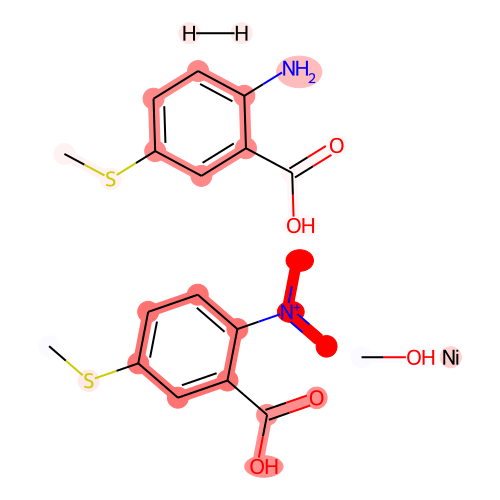

In [60]:
example_id = 0
tokens = ''.join(tokenizer.tokenize(data[example_id])[1:])
map_dict = map_atom2stridx(tokens)
mol = Chem.MolFromSmiles(tokens.replace('>>', '.'))
fgs, fgs_ch, fg_ids, fg_chids = mol2frag(mol, returnidx=True)
#mol_smi = Chem.MolFromSCCO.O=C(NOCCO)c1ccc(F)c(F)c1Nc1ccc(C#CCO)cc1F.[Pd]>>O=C(NOCCO)c1ccc(F)c(F)c1Nc1ccc(CCCO)cc1Fmiles(tokens.replace('>>','.'))
color_atoms = map_dict.keys()
shap_tokens = shap_values[example_id].values[:,labels[example_id]]
cs = colorscaler(shap_tokens)
bwr = cm.get_cmap('bwr', cs.max)
color_dicts_a = {}
color_dicts_b = {}
token_map = token2fg(fg_ids+fg_chids, map_dict)
for i,fg in enumerate(fg_ids+fg_chids):
    shap_val = shap_tokens[token_map[i]]
    for a in fg:
        color_dicts_a[a] = bwr(cs.convert(np.sum(shap_val)/5))#(1,1,1-np.max(np.exp(shap_val))/det*500)
for bond in mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_atoms and b in color_atoms and color_dicts_a[a]==color_dicts_a[b]:
        color_dicts_b[bond.GetIdx()] = color_dicts_a[a]
prettymol(mol, asMol=True, highlights={'highlightAtoms':color_atoms, 'highlightAtomColors':color_dicts_a, 'highlightBonds':{}, 'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b}, imgsize=(500,500))#, label='idx')

In [316]:
token2fg(fg_ids+fg_chids, map_dict)

{0: [1],
 1: [4],
 2: [16, 17, 11, 12, 13, 14, 19, 20, 21, 22, 10, 15, 18, 23],
 3: [28, 29, 26, 31, 25, 27, 30, 32],
 4: [43, 44, 45, 46],
 5: [50],
 6: [57, 56, 58],
 7: [63, 64, 61, 66, 60, 62, 65, 67],
 8: [5, 6, 7, 8, 9, 24, 33, 34],
 9: [51, 52, 53, 54, 55, 59, 68, 69],
 10: [0],
 11: [3],
 12: [36, 37, 38],
 13: [39, 40, 41],
 14: [49]}

## Reaction Yield Prediction

In [61]:
data = [
    "Yield:CCCC[C@H]1CCC(O)C1.Cc1ccc(S(=O)(=O)Cl)cc1.c1ccncc1>>CCCC[C@H]1CCC(OS(=O)(=O)c2ccc(C)cc2)C1", # 97
    "Yield:CN(C)CCCN.Cc1[nH]c2c(c1C(=O)O)CCCC2=O>>Cc1[nH]c2c(c1C(=O)NCCCN(C)C)CCCC2=O", # 83
    "Yield:CCc1cc(-c2ccc(S(=O)(=O)Cl)s2)c(C)[nH]c1=O.OCC1CCCNC1>>CCc1cc(-c2ccc(S(=O)(=O)N3CCCC(CO)C3)s2)c(C)[nH]c1=O", # 6
]

In [62]:
data = [
    "Yield:Ic1cccnc1.Cc1ccc(N)cc1>CN1CCCN2CCCN=C12.COc1ccc(OC)c([P+](C(C)(C)C)(C(C)(C)C)[Pd-2]2(OS(=O)(=O)C(F)(F)F)[NH2+]c3ccccc3-c3ccccc32)c1-c1c(C(C)C)cc(C(C)C)cc1C(C)C.CS(C)=O.c1ccc(-c2ccno2)cc1>Cc1ccc(Nc2cccnc2)cc1", # 92.96
    "Yield:Ic1cccnc1.Cc1ccc(N)cc1>CCN=P(N=P(N(C)C)(N(C)C)N(C)C)(N(C)C)N(C)C.COc1ccc(OC)c([P+](C(C)(C)C)(C(C)(C)C)[Pd-2]2(OS(=O)(=O)C(F)(F)F)[NH2+]c3ccccc3-c3ccccc32)c1-c1c(C(C)C)cc(C(C)C)cc1C(C)C.CS(C)=O.c1ccc(-c2ccno2)cc1>Cc1ccc(Nc2cccnc2)cc1", # 15.13
]

In [63]:
tokenizer = T5SimpleTokenizer(vocab_file='../models/temp_MFF2/vocab.pt', max_size=100)
model = T5ForSoftLabel.from_pretrained("../models/temp_MFF2/", loss_type='KLD')#.cuda()

In [64]:
def rxn_yield(x):
#     set_trace()
    tv = tokenizer.batch_encode_plus(x,return_tensors='pt',truncation=True,padding="longest")
#     attention_mask = (tv!=0).type(torch.int64)
    for k, v in tv.items():                                              
        if isinstance(v, torch.Tensor):                                     
            tv[k] = v.to(device)
    outputs = model(**tv).logits.detach().cpu().numpy()
#     scores = (np.exp(outputs).T / np.exp(outputs).sum(-1)).T
#     val = sp.special.logit(scores) 
    return outputs

In [65]:
labels = torch.softmax(torch.tensor(rxn_yield(data)), dim=1)
# 0.95

Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


In [66]:
labels

tensor([[0.0429, 0.9571],
        [0.8755, 0.1245]])

In [67]:
explainer = shap.Explainer(classifier,tokenizer,output_names=['0', '1'])
shap_values = explainer(data)
shap.plots.text(shap_values)

,Yield: I c 1 c c c n c 1 .,C c 1 c c c ( N ) c c 1 > C N 1 C,C C N 2 C C C N,= C 1 2 .,C O c 1 c c c ( O C ) c,( [ P + ] ( C ( C ),( C ) C ) ( C ( C ) ( C ) C ) [ P d - 2 ] 2,( O S ( = O ) ( = O ) C ( F ) ( F ) F ) [ N H 2 + ] c 3 c c c c c 3 - c 3 c c c c c 3 2 ),c 1 - c 1 c ( C ( C ) C ) c c ( C ( C ) C ),c c 1 C ( C ) C . C S ( C ) = O .,c 1 c c c ( - c 2 c c n o 2 ),c c 1 > C c 1 c c c ( N c 2 c c c n c 2 ) c c 1
0,-0.398,-0.102,-0.262,-0.31,0.413,-0.026,-0.059,-0.18,-0.157,0.024,-0.938,-0.389
1,0.091,0.06,0.107,0.102,-0.167,0.001,-0.002,0.029,0.02,-0.023,0.266,0.099


,Yield: I c 1,c c c n c 1 .,C c 1 c c c ( N ),c c 1 >,C C N = P,( N = P,( N ( C ) C ),( N ( C ) C ) N ( C ) C ),( N ( C ) C ) N ( C ) C .,C O c 1 c c c ( O C ) c ( [ P + ] ( C ( C ) ( C ) C ) ( C ( C ) ( C ) C ) [ P d - 2 ] 2,( O S ( = O ) ( = O ) C ( F ) ( F ) F ) [ N H 2 + ] c 3 c c c c c 3 - c 3 c c c c c 3 2 ) c 1 - c 1 c ( C ( C ) C ) c c ( C ( C ) C ),c c 1 C ( C ) C . C S ( C ) = O . c 1 c c c ( - c 2 c c n o 2 ) c c 1 > C c 1 c c c ( N c 2 c c c n c 2 ) c c 1
0,-0.005,0.063,-0.018,0.047,0.229,0.12,0.096,0.107,0.004,0.008,0.001,-0.023
1,-0.025,-0.16,-0.021,-0.077,-0.414,-0.255,-0.216,-0.19,-0.041,-0.077,-0.059,0.079


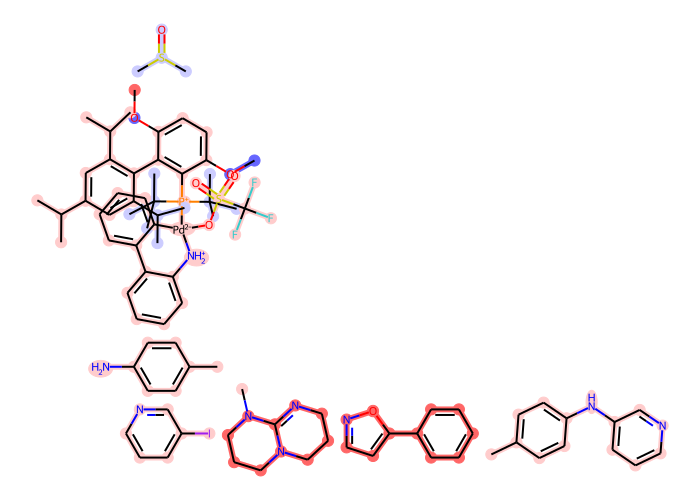

In [71]:
example_id = 0
tokens = ''.join(tokenizer.tokenize(data[example_id])[1:])
# print(tokens)
map_dict = map_atom2stridx(tokens)
mol = Chem.MolFromSmiles(tokens.replace('>>', '.')) if '>>' in tokens else Chem.MolFromSmiles(tokens.replace('>', '.'))
fgs, fgs_ch, fg_ids, fg_chids = mol2frag(mol, returnidx=True)
#mol_smi = Chem.MolFromSmiles(tokens.replace('>>','.'))
color_atoms = map_dict.keys()
shap_tokens = torch.sum(labels[example_id]*(shap_values[example_id].values), axis=1)
cs = colorscaler(shap_tokens)
bwr = cm.get_cmap('bwr', cs.max)
color_dicts_a = {}
color_dicts_b = {}
# print(torch.Tensor(shap_values[0].values[:, 366]))
# scaled = torch.sigmoid(torch.Tensor(shap_values[0].values[:, 366])**9)
# print(scaled)
for fg in fg_ids+fg_chids:
    shap_val = []
    for a in fg:
        shap_val.extend(shap_tokens[map_dict[a][0]:map_dict[a][1]].tolist())
    for a in fg:
        color_dicts_a[a] = bwr(cs.convert(np.max(shap_val)))#(1,1,1-np.max(np.exp(shap_val))/det*500)
for bond in mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_atoms and b in color_atoms and color_dicts_a[a]==color_dicts_a[b]:
        color_dicts_b[bond.GetIdx()] = color_dicts_a[a]
prettymol(mol, asMol=True, highlights={'highlightAtoms':color_atoms, 'highlightAtomColors':color_dicts_a, 'highlightBonds':{}, 'highlightBonds':color_dicts_b.keys(),'highlightBondColors':color_dicts_b}, imgsize=(700,500))#, label='idx')

In [59]:
color_dicts_a

{0: (1.0, 0.7999999999999998, 0.7999999999999998),
 12: (1.0, 0.7999999999999998, 0.7999999999999998),
 24: (1.0, 0.4, 0.4),
 25: (1.0, 0.4, 0.4),
 16: (1.0, 0.4, 0.4),
 20: (1.0, 0.4, 0.4),
 27: (0.4, 0.4, 1.0),
 32: (0.4, 0.4, 1.0),
 53: (1.0, 0.7999999999999998, 0.7999999999999998),
 44: (1.0, 0.7999999999999998, 0.7999999999999998),
 35: (1.0, 0.7999999999999998, 0.7999999999999998),
 45: (1.0, 0.7999999999999998, 0.7999999999999998),
 46: (1.0, 0.7999999999999998, 0.7999999999999998),
 47: (1.0, 0.7999999999999998, 0.7999999999999998),
 48: (1.0, 0.7999999999999998, 0.7999999999999998),
 50: (1.0, 0.7999999999999998, 0.7999999999999998),
 51: (1.0, 0.7999999999999998, 0.7999999999999998),
 52: (1.0, 0.7999999999999998, 0.7999999999999998),
 85: (0.8, 0.8, 1.0),
 83: (0.8, 0.8, 1.0),
 102: (1.0, 0.7999999999999998, 0.7999999999999998),
 2: (1.0, 0.7999999999999998, 0.7999999999999998),
 1: (1.0, 0.7999999999999998, 0.7999999999999998),
 6: (1.0, 0.7999999999999998, 0.79999999999999

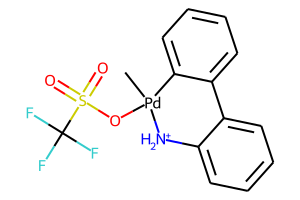

In [62]:
prettymol("C[Pd]1([NH2+]C2=CC=CC=C2C2=CC=CC=C12)OS(=O)(=O)C(F)(F)F")

In [63]:
from rdkit.Chem import rdAbbreviations

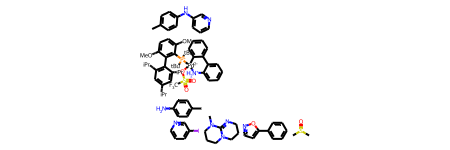

In [64]:
abbrevs = rdAbbreviations.GetDefaultAbbreviations()
nm = rdAbbreviations.CondenseMolAbbreviations(mol,abbrevs)
nm

In [143]:
atom1.GetPropsAsDict(), atom1.SetProp('_dis','No')

({'__computedProps': <rdkit.rdBase._vectSs at 0x1482905fded0>,
  'atomLabel': 'CF3',
  '_displayLabel': 'CF<sub>3</sub>',
  '_displayLabelW': 'F<sub>3</sub>C',
  '_dis': 'No'},
 None)

In [142]:
for atom1, atom2 in zip(nm.GetAtoms(), mol.GetAtoms()):
    print(atom1.GetIdx(), atom1.GetSymbol(),atom2.GetIdx(), atom2.GetSymbol())

0 * 0 I
1 Pd 1 C
2 N 2 C
3 C 3 C
4 C 4 C
5 C 5 N
6 C 6 C
7 C 7 C
8 C 8 C
9 C 9 C
10 C 10 C
11 C 11 C
12 C 12 N
13 C 13 C
14 C 14 C
15 O 15 C
16 S 16 N
17 O 17 C
18 O 18 C
19 * 19 C


In [72]:
len(nm.GetAtoms()), len(mol.GetAtoms())

(94, 111)

In [184]:
bwr(1)

(0.4, 0.4, 1.0, 1.0)

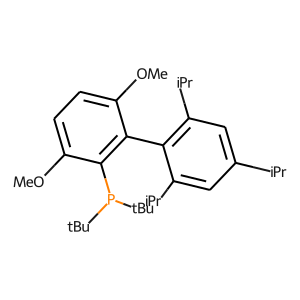

In [189]:
color_dicts_a_new = {}
color_dicts_b_new = {}
abbrevs = rdAbbreviations.GetDefaultAbbreviations()
sub_mol = Chem.MolFromSmiles("COC1=CC=C(OC)C(=C1P(C(C)(C)C)C(C)(C)C)C1=C(C=C(C=C1C(C)C)C(C)C)C(C)C")
nm = rdAbbreviations.CondenseMolAbbreviations(sub_mol,abbrevs)
for a in nm.GetAtoms():
    if a.GetIdx() == 0:
        a.SetProp('atomLabel', 'L')
        a.SetProp('_displayLabel', 'L')
    color_dicts_a_new[a.GetIdx()] = (1.0, 0.7999999999999998, 0.7999999999999998)
color_dicts_a_new.update({9:(0.8, 0.8, 1.0), 10:(0.8, 0.8, 1.0), 19:(0.8, 0.8, 1.0), 0:(0.4, 0.4, 1.0), 5:bwr(3)})
for bond in nm.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_dicts_a_new and b in color_dicts_a_new and color_dicts_a_new[a]==color_dicts_a_new[b]:
        color_dicts_b_new[bond.GetIdx()] = color_dicts_a_new[a]
prettymol(nm, asMol=True, imgsize=(300,300))#,highlights={'highlightAtoms':color_dicts_a_new.keys(), 
#                                                          'highlightAtomColors':color_dicts_a_new, 
#                                                          'highlightBonds':color_dicts_b_new.keys(),
#                                                          'highlightBondColors':color_dicts_b_new,
#                                                         })

33 (0.4, 0.4, 1.0)
32 (0.4, 0.4, 1.0)
31 (1.0, 0.7999999999999998, 0.7999999999999998)
30 (1.0, 0.7999999999999998, 0.7999999999999998)
29 (1.0, 0.7999999999999998, 0.7999999999999998)
28 (1.0, 0.7999999999999998, 0.7999999999999998)
27 (0.4, 0.4, 1.0)
26 (1.0, 0.4, 0.4)
66 (1.0, 0.7999999999999998, 0.7999999999999998)
34 (1.0, 0.7999999999999998, 0.7999999999999998)
35 (1.0, 0.7999999999999998, 0.7999999999999998)
36 (0.8, 0.8, 1.0)
37 (0.8, 0.8, 1.0)
38 (0.8, 0.8, 1.0)
39 (0.8, 0.8, 1.0)
40 (0.8, 0.8, 1.0)
41 (0.8, 0.8, 1.0)
42 (0.8, 0.8, 1.0)
43 (0.8, 0.8, 1.0)
67 (1.0, 0.7999999999999998, 0.7999999999999998)
68 (1.0, 0.7999999999999998, 0.7999999999999998)
72 (1.0, 0.7999999999999998, 0.7999999999999998)
73 (1.0, 0.7999999999999998, 0.7999999999999998)
77 (1.0, 0.7999999999999998, 0.7999999999999998)
78 (1.0, 0.7999999999999998, 0.7999999999999998)
79 (0.8, 0.8, 1.0)
80 (0.8, 0.8, 1.0)
81 (0.8, 0.8, 1.0)
74 (1.0, 0.7999999999999998, 0.7999999999999998)
75 (1.0, 0.7999999999999998, 

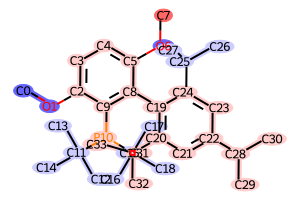

In [153]:
color_dicts_a_new = {}
color_dicts_b_new = {}
sub_mol = Chem.MolFromSmiles("COC1=CC=C(OC)C(=C1P(C(C)(C)C)C(C)(C)C)C1=C(C=C(C=C1C(C)C)C(C)C)C(C)C")
for a,b in zip(sub_mol.GetAtoms(), mol.GetSubstructMatch(sub_mol)):
    color_dicts_a_new[a.GetIdx()] = color_dicts_a[b]
    print(b,color_dicts_a[b])
for bond in sub_mol.GetBonds():
    a = bond.GetBeginAtom().GetIdx()
    b = bond.GetEndAtom().GetIdx()
    if a in color_dicts_a_new and b in color_dicts_a_new and color_dicts_a_new[a]==color_dicts_a_new[b]:
        color_dicts_b_new[bond.GetIdx()] = color_dicts_a_new[a]
prettymol(sub_mol, asMol=True, label='idx', highlights={'highlightAtoms':color_dicts_a_new.keys(), 'highlightAtomColors':color_dicts_a_new,'highlightBonds':color_dicts_b_new.keys(),'highlightBondColors':color_dicts_b_new})#, imgsize=(700,500), label='idx')

In [131]:
color_dicts_a_new

{0: (0.4, 0.4, 1.0),
 1: (0.4, 0.4, 1.0),
 2: (1.0, 0.7999999999999998, 0.7999999999999998),
 3: (1.0, 0.7999999999999998, 0.7999999999999998),
 4: (1.0, 0.7999999999999998, 0.7999999999999998),
 5: (1.0, 0.7999999999999998, 0.7999999999999998),
 6: (0.4, 0.4, 1.0),
 7: (1.0, 0.4, 0.4),
 8: (1.0, 0.7999999999999998, 0.7999999999999998),
 9: (1.0, 0.7999999999999998, 0.7999999999999998),
 10: (1.0, 0.7999999999999998, 0.7999999999999998),
 11: (0.8, 0.8, 1.0),
 12: (0.8, 0.8, 1.0),
 13: (0.8, 0.8, 1.0),
 14: (0.8, 0.8, 1.0),
 15: (0.8, 0.8, 1.0),
 16: (0.8, 0.8, 1.0),
 17: (0.8, 0.8, 1.0),
 18: (0.8, 0.8, 1.0),
 19: (1.0, 0.7999999999999998, 0.7999999999999998),
 20: (1.0, 0.7999999999999998, 0.7999999999999998),
 21: (1.0, 0.7999999999999998, 0.7999999999999998),
 22: (1.0, 0.7999999999999998, 0.7999999999999998),
 23: (1.0, 0.7999999999999998, 0.7999999999999998),
 24: (1.0, 0.7999999999999998, 0.7999999999999998),
 25: (0.8, 0.8, 1.0),
 26: (0.8, 0.8, 1.0),
 27: (0.8, 0.8, 1.0),
 28: